### Averon Notebook for predicting actionable cancer vulnerabilities enabled by mutant-directed protein-protein interactions.<br>
Authors: Hongyue (Nicole) Chen and Andrey A. Ivanov<br>
Contact author
Ivanov Lab, Department of Pharmacology and Chemical Biology,<br>
Emory University School of Medicine,<br>
Emory University<br>
Atlanta, GA 30322, USA<br>

### Preparation
#### Make sure the parent_folder is set to the root Averon folder

In [1]:
#Make sure the parent_folder is set to the root Averon folder
%reset
import os
parent_folder = "C:\\AVERON\\"
os.chdir(parent_folder+"notebook")

Once deleted, variables cannot be recovered. Proceed (y/[n])?  y


### Install required packages

In [ ]:
#pip install -r requirements.txt

#### Import essential dependencies and setup general environment

In [2]:
#Import essentials
os.chdir(parent_folder)
import warnings
warnings.filterwarnings('ignore')
import sys, os, importlib,ipycytoscape,requests,pygtop,lifelines
import pandas as pd
import matplotlib.pyplot as plt
import ipywidgets as widgets
#import tkinter;
import matplotlib
import seaborn as sns
from IPython.display import display, HTML
sys.path.insert(0, os.path.abspath('src'))
import averon as av
pd.set_option("display.max_rows", None)
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
pd.set_option('display.max_columns', None) #unlimit number of columns to show in dataframes
%matplotlib inline

#### Define the folders

In [3]:
#Define folders

#Set output folders:
project_folder = parent_folder+"Projects"+"/" #save data files, e.g. tbles, here

#Folder with all input files:
data_folder = parent_folder+"input"+"/"

#pathway folder.
pathway_folder = data_folder+"pathway_genesets/MSigDB/"

#Set input files
genomics_clinical_folder = data_folder+"genomics_and_clinical/"

#HGNC gene annotations from https://www.genenames.org/
hgnc_f = genomics_clinical_folder + "hgnc5.txt"

#Mutation data from https://gdc.cancer.gov/about-data/publications/pancanatlas
#mut_f = genomics_clinical_folder +"mc3.v0.2.8.PUBLIC.maf" 
mut_f = genomics_clinical_folder +"braf_v600e.maf" 

#mRNA expression data from https://gdc.cancer.gov/about-data/publications/pancanatlas
exp_f = genomics_clinical_folder + "EBPlusPlusAdjustPANCAN_IlluminaHiSeq_RNASeqV2.geneExp.refined.tsv" 
    
#CNV data from https://gdc.cancer.gov/about-data/publications/pancan-aneuploidy
#cnv_f = genomics_clinical_folder + "all_thresholded.by_genes_whitelisted.refined.tsv"

#Clinical data from https://gdc.cancer.gov/about-data/publications/pancanatlas
clinical_f = genomics_clinical_folder + "TCGA-CDR-SupplementalTableS1.tsv"

#Clinical with Follow-up from https://gdc.cancer.gov/about-data/publications/pancanatlas
# used to get bcr_patient_uuid
uuid_f = genomics_clinical_folder + "clinical_PANCAN_patient_with_followup.tsv"

params = {}
params['projects_folder']=project_folder
params['mut_f']=mut_f
params['exp_f']=exp_f
params['clinical_f']=clinical_f
params['uuid_f']=uuid_f
params['hgnc_f']=hgnc_f
params['data_folder']=data_folder
params['pathway_folder']=pathway_folder
params['genomics_clinical_folder']=genomics_clinical_folder

### Check the files and folders

In [4]:
#Check files & folders
av.check_files(params)

Files & Folders check completed. All files and folders are in place.


#### Download and refine TCGA PanCancer Atlas Expression data

In [5]:
#Download TCGA expression data
exp_f = av.download_and_refine_tcga_exp_data(params)

/root/capsule/AVERON/input/genomics_and_clinical/EBPlusPlusAdjustPANCAN_IlluminaHiSeq_RNASeqV2.geneExp.refined.tsv is already exist. Nothing to do.


### Create new project

In [6]:
#New project

#Proved Project name:
project_name = "Project1"
params = av.new_project(project_name,project_folder,params)
tbl_folder = params['tbl_folder']
net_folder = params['net_folder']
fig_folder = params['fig_folder']

#### Get TCGA Patient IDs

In [7]:
#Get TCGA Patient IDs
barcode_df = av.prepare_cancer_barcodes(clinical_f)
cancers = barcode_df.columns.tolist()
barcode_df.head(3)
params['barcode_df']=barcode_df

#### Get genes with available mRNA expression data

In [8]:
#Get genes with mRNA expression data
genes_with_expression=av.get_mRNA_expession(exp_f)
print("A total of ",len(genes_with_expression), "genes with expression data")

A total of  20529 genes with expression data


#### Get protein coding genes

In [9]:
#Get protein coding genes
hgnc_df = pd.read_csv(hgnc_f,sep='\t',index_col = 0)
hgnc_df.set_index('Approved symbol',inplace=True)
coding_genes = av.get_coding_genes(hgnc_df.copy()).index.values
params['coding_genes']=coding_genes
print("There is a total of",len(coding_genes),"coding genes")

There is a total of 19675 coding genes


### <span style="color:red;">Specify tumor driver and mutation(s)</span>

In [10]:
#Define the mutant driver
driver_gene = 'BRAF'
driver_mut = ['p.V600E'] #array of point mutations or mut = 'ALL' for all mutants
params['driver_gene']=driver_gene
params['driver_mut']=driver_mut

### Get mutation frequency across cancer types

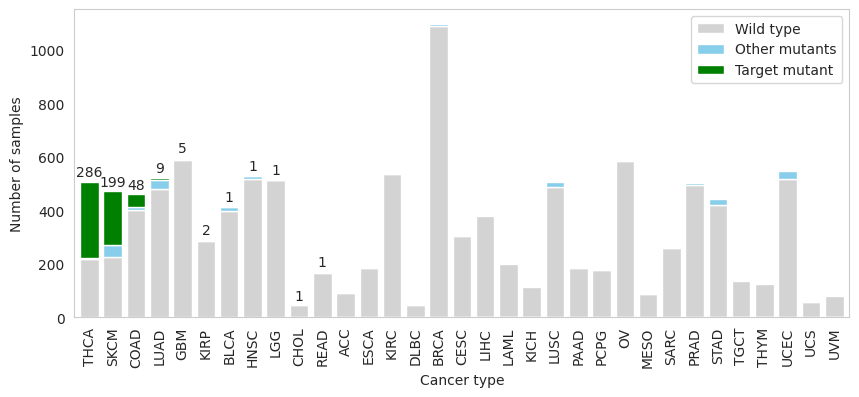

In [11]:
#Mutation frequency
fig,cancers_df=av.get_cancer_mutation_freq(barcode_df,mut_f,driver_gene,driver_mut,cancers)

In [12]:
#Save the graph
fig.savefig(fig_folder+av.gen_filename(driver_gene,driver_mut,"_frequency_across_cancers",".png"), dpi=600,format='png')

##### Show the mutation frequency as a table

In [13]:
#Show mutation frequency
#Save the table
tbl_file = tbl_folder+av.gen_filename(driver_gene,driver_mut,"_frequency_across_cancers",".tsv")
cancers_df.to_csv(tbl_file,sep='\t')
cancers_df

,Wild type,Other mutants,Target mutant
THCA,216,5,286
SKCM,223,48,199
COAD,401,10,48
LUAD,480,33,9
GBM,587,4,5
KIRP,286,3,2
BLCA,397,14,1
HNSC,518,9,1
LGG,512,2,1
CHOL,44,0,1


### <span style="color:red;"> Define binding partners</span>

#### Upload binding partners from file

In [14]:
#Load partners
ppi_file = data_folder + "BRAF_neo_partners_example.txt"
partners = av.load_partners(ppi_file)
params['partners']=partners

There are 3 partners


#### or provide binding partners manually

In [15]:
#Enter partners manually
partners = ['AURKA', 'CDK4', 'RAB25']
for partner in partners:
    if partner not in genes_with_expression:
        print(partner,"not in MUT/EXP dataset. Check gene name.")
params['partners']=partners

#### Get binding prtner annotations

In [16]:
#Get binding partner annotations
partner_hgnc_df = av.get_partner_info(partners, hgnc_df)
partner_hgnc_df.to_csv(tbl_folder+"binding_partners.csv",sep=',')
partner_hgnc_df.head(3)

,HGNC ID,Approved name,Previous symbols,Alias symbols,Accession numbers,RefSeq IDs,Alias names,Previous name,NCBI Gene ID,Ensembl gene ID,OMIM ID,RefSeq,UniProt ID
Approved symbol,,,,,,,,,,,,,
AURKA,HGNC:11393,aurora kinase A,"STK15, STK6","BTAK, AurA, STK7, ARK1, PPP1R47, AIK",BC001280,NM_003600,"protein phosphatase 1, regulatory subunit 47, ...","serine/threonine kinase 15, "" serine/threonine...",6790,ENSG00000087586,603072,NM_001323303,O14965
CDK4,HGNC:1773,cyclin dependent kinase 4,NaN,PSK-J3,M14505,NM_000075,NaN,NaN,1019,ENSG00000135446,123829,NM_000075,P11802
RAB25,HGNC:18238,"RAB25, member RAS oncogene family",NaN,CATX-8,AF083124,NaN,NaN,NaN,57111,ENSG00000132698,612942,NM_020387,P57735


### <span style="color:red;">Indicate the cancer type for the analysis</span>

In [17]:
#Indicate the cancer type
cancer = 'SKCM'

### Get cancer samples with and without driver mutations

#### Extract the data from TCGA files

In [18]:
#Get expression data
df_mut_exp_samples,df_wt_exp_samples =av.get_wt_mut_expression(cancer,params)
df_mut_exp_samples.head(3)

Total samples: 470
Samples with target mutation(s): 204
Wild type samples: 224


,TCGA-BF-A1PU,TCGA-BF-A1PX,TCGA-BF-A3DJ,TCGA-BF-A3DL,TCGA-BF-A3DM,TCGA-BF-A3DN,TCGA-BF-A5EQ,TCGA-BF-A5ER,TCGA-BF-A9VF,TCGA-BF-AAP0,TCGA-BF-AAP6,TCGA-BF-AAP7,TCGA-D3-A1Q4,TCGA-D3-A1Q5,TCGA-D3-A1Q6,TCGA-D3-A1Q7,TCGA-D3-A1Q9,TCGA-D3-A2J7,TCGA-D3-A2JA,TCGA-D3-A2JD,TCGA-D3-A2JE,TCGA-D3-A2JG,TCGA-D3-A2JK,TCGA-D3-A2JN,TCGA-D3-A2JP,TCGA-D3-A3C1,TCGA-D3-A3C3,TCGA-D3-A3C6,TCGA-D3-A3C7,TCGA-D3-A3CB,TCGA-D3-A3CE,TCGA-D3-A3MO,TCGA-D3-A3MR,TCGA-D3-A3MU,TCGA-D3-A51J,TCGA-D3-A51N,TCGA-D3-A5GN,TCGA-D3-A5GR,TCGA-D3-A5GS,TCGA-D3-A5GT,TCGA-D3-A5GU,TCGA-D3-A8GB,TCGA-D3-A8GD,TCGA-D3-A8GJ,TCGA-D3-A8GN,TCGA-D3-A8GO,TCGA-D3-A8GS,TCGA-D3-A8GV,TCGA-D9-A148,TCGA-D9-A1JX,TCGA-D9-A3Z3,TCGA-D9-A4Z2,TCGA-D9-A6E9,TCGA-D9-A6EG,TCGA-DA-A1HW,TCGA-DA-A1HY,TCGA-DA-A1I0,TCGA-DA-A1I2,TCGA-DA-A1I4,TCGA-DA-A1I5,TCGA-DA-A1I7,TCGA-DA-A1I8,TCGA-DA-A3F5,TCGA-DA-A3F8,TCGA-DA-A95W,TCGA-EB-A24C,TCGA-EB-A299,TCGA-EB-A3HV,TCGA-EB-A3XB,TCGA-EB-A3XD,TCGA-EB-A3XE,TCGA-EB-A3XF,TCGA-EB-A3Y6,TCGA-EB-A42Z,TCGA-EB-A430,TCGA-EB-A431,TCGA-EB-A44N,TCGA-EB-A44P,TCGA-EB-A4IS,TCGA-EB-A4P0,TCGA-EB-A550,TCGA-EB-A553,TCGA-EB-A5FP,TCGA-EB-A5SE,TCGA-EB-A5UN,TCGA-EB-A6QY,TCGA-EB-A6QZ,TCGA-EB-A6R0,TCGA-EB-A85I,TCGA-EE-A17Y,TCGA-EE-A183,TCGA-EE-A20B,TCGA-EE-A20F,TCGA-EE-A20H,TCGA-EE-A29A,TCGA-EE-A29C,TCGA-EE-A29E,TCGA-EE-A29H,TCGA-EE-A29M,TCGA-EE-A29P,TCGA-EE-A29T,TCGA-EE-A29W,TCGA-EE-A2A6,TCGA-EE-A2GB,TCGA-EE-A2GE,TCGA-EE-A2GH,TCGA-EE-A2GS,TCGA-EE-A2GT,TCGA-EE-A2M5,TCGA-EE-A2M6,TCGA-EE-A2M7,TCGA-EE-A2M8,TCGA-EE-A2ME,TCGA-EE-A2MG,TCGA-EE-A2MH,TCGA-EE-A2MK,TCGA-EE-A2MP,TCGA-EE-A3AB,TCGA-EE-A3AD,TCGA-EE-A3AF,TCGA-EE-A3AG,TCGA-EE-A3AH,TCGA-EE-A3J3,TCGA-EE-A3J4,TCGA-EE-A3JB,TCGA-EE-A3JE,TCGA-ER-A198,TCGA-ER-A19B,TCGA-ER-A19C,TCGA-ER-A19E,TCGA-ER-A19G,TCGA-ER-A19H,TCGA-ER-A19J,TCGA-ER-A19K,TCGA-ER-A19M,TCGA-ER-A19O,TCGA-ER-A19P,TCGA-ER-A19Q,TCGA-ER-A19S,TCGA-ER-A2NC,TCGA-ER-A2ND,TCGA-ER-A2NG,TCGA-ER-A3PL,TCGA-ER-A42K,TCGA-ER-A42L,TCGA-FR-A44A,TCGA-FR-A728,TCGA-FR-A729,TCGA-FR-A7UA,TCGA-FR-A8YE,TCGA-FS-A1YX,TCGA-FS-A1YY,TCGA-FS-A1Z7,TCGA-FS-A1ZC,TCGA-FS-A1ZD,TCGA-FS-A1ZF,TCGA-FS-A1ZH,TCGA-FS-A1ZM,TCGA-FS-A1ZN,TCGA-FS-A1ZR,TCGA-FS-A1ZS,TCGA-FS-A4F8,TCGA-FS-A4FB,TCGA-FW-A3TV,TCGA-FW-A5DX,TCGA-GF-A2C7,TCGA-GF-A4EO,TCGA-GF-A6C8,TCGA-GF-A6C9,TCGA-GF-A769,TCGA-GN-A262,TCGA-GN-A263,TCGA-GN-A265,TCGA-GN-A26A,TCGA-GN-A4U5,TCGA-GN-A4U7,TCGA-GN-A4U8,TCGA-GN-A9SD,TCGA-HR-A2OH,TCGA-HR-A5NC,TCGA-IH-A3EA,TCGA-LH-A9QB,TCGA-OD-A75X,TCGA-QB-A6FS,TCGA-W3-AA1Q,TCGA-W3-AA1R,TCGA-W3-AA1W,TCGA-W3-AA21,TCGA-WE-A8K5,TCGA-WE-A8K6,TCGA-WE-A8ZQ,TCGA-WE-A8ZR,TCGA-WE-A8ZT,TCGA-WE-A8ZX,TCGA-WE-AAA0,TCGA-WE-AAA4,TCGA-XV-A9W5,TCGA-XV-AAZV,TCGA-XV-AAZW,TCGA-YD-A9TB,TCGA-YG-AA3N,TCGA-Z2-A8RT,TCGA-Z2-AA3V
gene_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
EZHIP,0.000000,0.000000,1.445303,0.0,0.971516,0.902961,0.523361,0.000000,1.843903,0.487795,1.539630,1.873223,2.244735,9.760490,0.546364,0.658737,5.816451,0.0,0.00000,0.000000,0.000000,0.459851,0.0,0.000000,0.0,1.592684,4.596971,0.0,0.000000,1.389952,3.084439,3.150901,0.945233,0.000000,0.819259,0.702835,0.000000,0.842134,0.000000,0.0,0.0,2.725196,3.459576,0.000000,2.137962,3.319531,2.887974,2.984152,0.000000,0.000000,0.443819,0.414677,0.000000,0.372841,0.361993,2.451488,0.000000,0.303109,1.492417,2.293282,0.000000,3.491353,2.793584,0.715542,2.808632,0.0,1.975594,1.337369,0.000000,0.0,1.035905,0.000000,0.803806,0.000000,0.000000,0.000000,1.116032,2.532242,1.063986,0.000000,2.430928,0.000000,0.000000,0.000000,1.872159,0.811307,0.000000,5.370890,1.121214,0.000000,0.781737,0.000000,2.794977,2.777641,0.0,0.0,0.0,1.228542,0.422233,1.273695,2.088888,0.781905,0.414569,3.675172,0.748461,1.924062,1.754417,0.979513,0.000000,0.368265,1.057624,0.809003,1.651362,1.589188,1.101650,0.84318,6.577912,1.408549,2.235635,0.000000,0.363451,0.000000,0.000000,0.000000,0.927138,1.882917,0.0,0.0,0.780058,0.483468,5.153197,0.0,0.441483,0.000000,0.000000,0.000

### Calculate PPI scores for a single cancer type

In [19]:
#Calculate PPI scores
all_mut_score_nn_df,all_wt_score_nn_df,scores_mut_nn_df,scores_wt_nn_df = av.calculate_ppi_scores_not_scaled(cancer,params,
                                                                                        df_wt_exp_samples,df_mut_exp_samples)
all_mut_score_nn_df.head(3)

,AURKA,CDK4,RAB25
TCGA-BF-A1PU,7.733054,8.640810,5.334151
TCGA-BF-A1PX,8.075671,9.305598,8.799707
TCGA-BF-A3DJ,7.675412,9.417669,7.459076


#### Heatmap of co-regulated neoPPIs

Average correlation: 0.2471241795981188


,AURKA,CDK4,RAB25
AURKA,1.000000,0.704683,0.014115
CDK4,0.704683,1.000000,0.022575
RAB25,0.014115,0.022575,1.000000


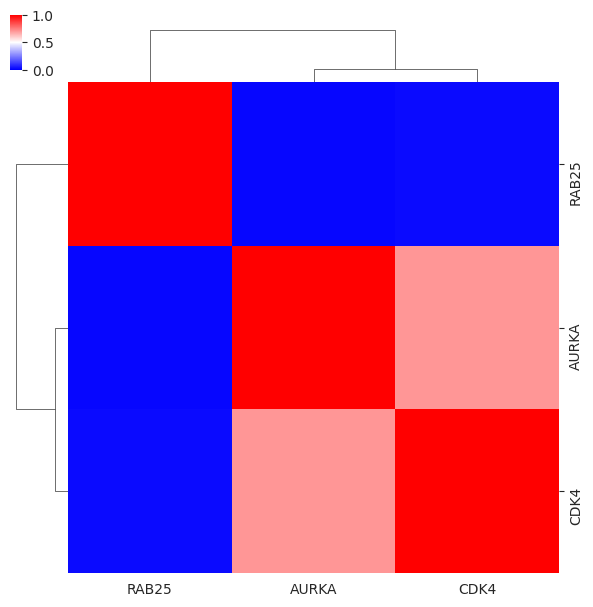

In [20]:
#Heatmap of co-regulated neoPPIs

#The heatmap shows pairwise correlations between neoPPI scores
corr = av.coregulated_neoppis_map(all_mut_score_nn_df,fig_folder,cancer,'ward',10,10)
corr.head()

In [21]:
corr.head()

,AURKA,CDK4,RAB25
AURKA,1.000000,0.704683,0.014115
CDK4,0.704683,1.000000,0.022575
RAB25,0.014115,0.022575,1.000000


#### Distribution of Pearson correlation between PPI scores and mRNA expression

,GENE,R
0,AURKA,0.751952
1,CDK4,0.568388
2,RAB25,0.964029


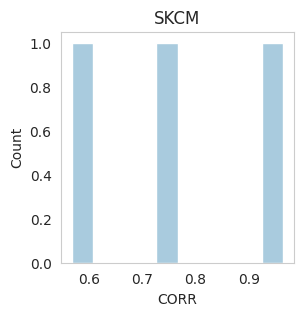

In [22]:
#PPI score/mRNA expression correlation
fig, distr_df = av.get_neoPPI_cross_correlation_distr(all_mut_score_nn_df,df_mut_exp_samples,cancer,fig_folder)
distr_df

In [23]:
#Save the histogram
distr_df.to_csv(tbl_folder+av.gen_filename(driver_gene,driver_mut,cancer,'_hist.csv'),sep=',')

### Calculate PPI scores for multiple cancer types

In [24]:
#PPI scores for multiple cancers
ppi_score_dict = av.get_ppi_scores_multiple_cancers(['THCA','COAD','SKCM'],params)

THCA
Total samples: 507
Samples with target mutation(s): 287
Wild type samples: 217
COAD
Total samples: 459
Samples with target mutation(s): 48
Wild type samples: 402
SKCM
Total samples: 470
Samples with target mutation(s): 204
Wild type samples: 224


#### Compare PPI scores across different cancer types

In [25]:
#Compare PPI scores
compare_ppi_scores_df=av.compare_ppi_scores(ppi_score_dict,partners)
compare_ppi_scores_df.head(3)

,THCA_AVR,THCA_SD,PVAL_THCA-COAD,FC_THCA-COAD,PVAL_THCA-SKCM,FC_THCA-SKCM,COAD_AVR,COAD_SD,PVAL_COAD-SKCM,FC_COAD-SKCM,SKCM_AVR,SKCM_SD,KW_H_Test_PVAL,KW_H_Test_QVAL
AURKA,6.471274,0.374733,1.024753e-22,0.806738,2.815720e-79,0.783450,8.021526,0.453673,2.275860e-01,0.971132,8.259974,0.606124,8.558464e-85,2.567539e-84
CDK4,9.414593,0.242711,2.520909e-09,1.043381,1.637437e-09,0.973842,9.023164,0.419915,4.212778e-20,0.933353,9.667475,0.486222,9.454810e-22,9.454810e-22
RAB25,9.309399,0.224937,1.258029e-06,1.043885,9.793123e-85,1.944842,8.918035,0.336973,1.972900e-10,1.863081,4.786713,1.486265,7.996764e-84,1.199515e-83


In [26]:
#Save it!
compare_ppi_scores_df.to_csv(tbl_folder+av.gen_filename(driver_gene,driver_mut,'COAD_SKCM_THCA','_AVR_neoPPIscores.csv'),sep=',')

#### Heatmap: neoPPI scores averaged across cancer types

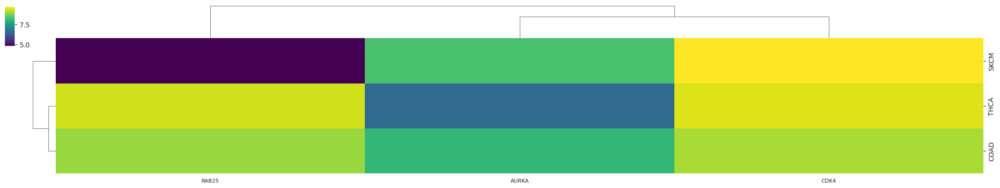

In [27]:
#Get the heatmap
g=av.get_neo_ppi_score_heatmap(compare_ppi_scores_df)

In [28]:
#Save the heatmap
fig_file = fig_folder+av.gen_filename(driver_gene,driver_mut,'COAD_SKCM_THCA','_neoPPI_heatmap.png')
g.savefig(fig_file, dpi=600,format='png')

#### Heatmap: neoPPI scores per tumor sample

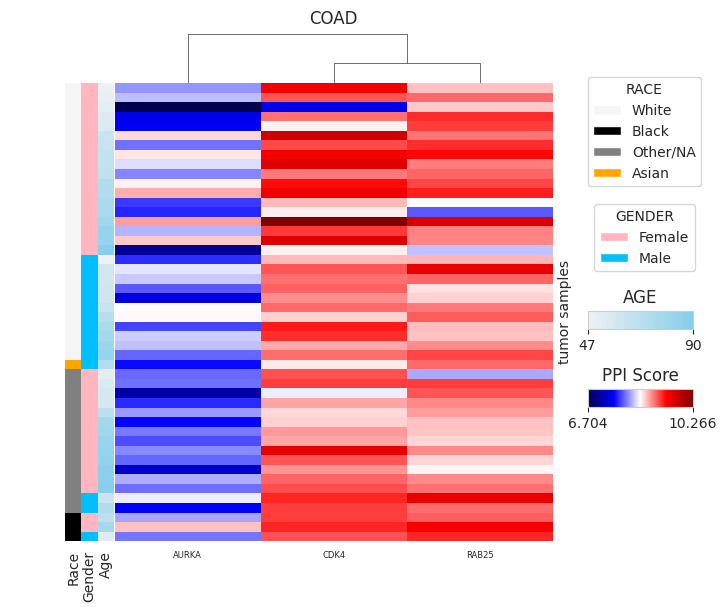

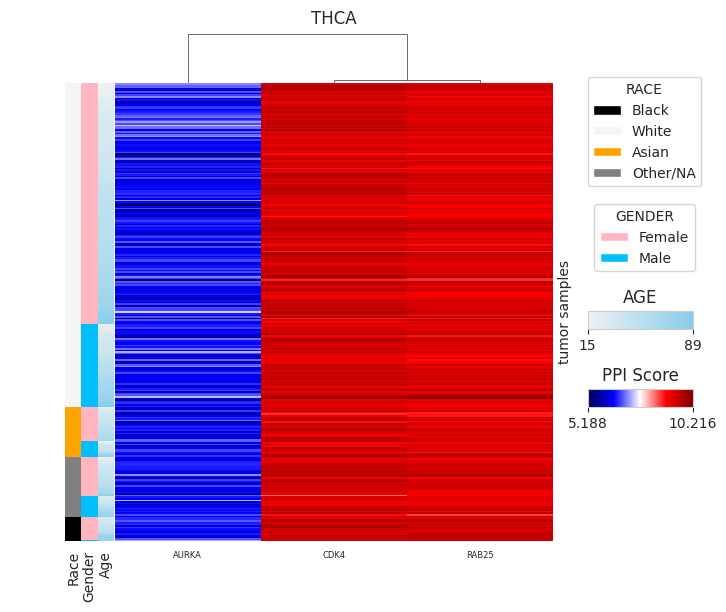

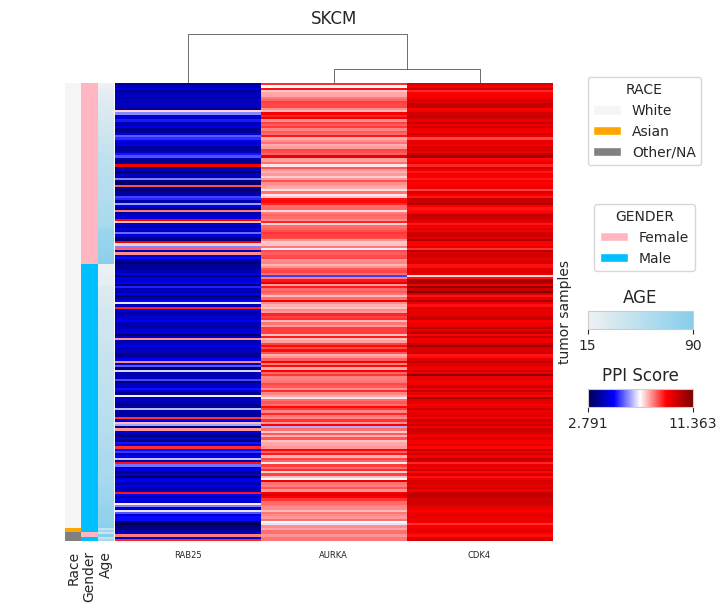

In [29]:
#Hetmaps of neoPPI scores per tumor sample
out = {}
for cancer in ['COAD','THCA','SKCM']:
    g,out_df = av.build_heatmap(cancer,ppi_score_dict,params,['Race','Gender','Age'])
    out[cancer]=out_df

#### Box plots for neoPPI score distribution

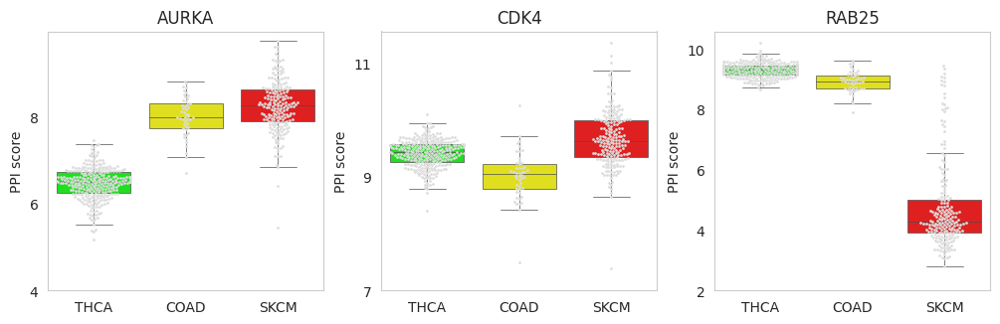

In [30]:
#neoPPI score distribution box plots

cancers = ['THCA','COAD','SKCM']
#genes = ['GOT1','CNKSR1','AJUBA','NOX1','CHD1L','DLL3']
genes = partners
colors = ['#00FF00', '#FFFF00', '#FF0000']
fig=av.boxplot_neoppi_score_distribution(genes,cancers,ppi_score_dict,colors,'gainsboro')

In [31]:
#Save it
fig_file = fig_folder+av.gen_filename(driver_gene,driver_mut,'COAD_SKCM_THCA',"_neoPPI_distribution_boxplots1.pdf")
fig.savefig(fig_file, dpi=600,format='pdf')

In [32]:
#Get the PPIScore values
partner = "AURKA"
cancer = "SKCM"
av.get_ppi_values(cancer,partner,ppi_score_dict)        

,AURKA_PPIscores
TCGA-FW-A5DX,9.756476
TCGA-EE-A3AG,9.627336
TCGA-D3-A3C3,9.622898
TCGA-EE-A2MH,9.547863
TCGA-ER-A19M,9.465188
TCGA-ER-A19Q,9.431859
TCGA-W3-AA1R,9.338097
TCGA-ER-A19E,9.336911
TCGA-EB-A6QY,9.327368
TCGA-OD-A75X,9.307526


#### Get sample details

In [33]:
#Get sample details
av.get_sample_info('TCGA-FW-A5DX')

uuid,889ae822-add8-4a10-abe0-50176c858f80
patient barcode,TCGA-FW-A5DX
disease type,Nevi and Melanomas
tissue or organ of origin,"Skin, NOS"
age at diagnosis,71 years 123 days
ajcc pathologic stage,Stage IIIC
race,white
gender,male
ethnicity,not hispanic or latino
vital status,Alive



The data is derived from the NCI GDC Data Portal: https://portal.gdc.cancer.gov


### <span style="color:red;">Correlation between neoPPI scores and clinical outcomes.</span>

#### Define cancer type for the analysis 

In [34]:
#Define cancer type & update PPI scores
cancer = 'SKCM'
df_mut_exp_samples,df_wt_exp_samples = av.get_wt_mut_expression(cancer,params)
all_mut_score_nn_df,all_wt_score_nn_df,scores_mut_nn_df,scores_wt_nn_df = av.calculate_ppi_scores_not_scaled(cancer,params,
                                                                                        df_wt_exp_samples,df_mut_exp_samples)

Total samples: 470
Samples with target mutation(s): 204
Wild type samples: 224


#### Get clinical data for mutant samples

#### Conduct survival analysis and show survival plots

IntProgress(value=0, max=3)

,PARTNER,MEDIAN_TIME_HIGH,MEDIAN_TIME_LOW,PVALUE,QVALUE
0,AURKA,6.580819,14.569858,0.034362,0.085986
1,CDK4,6.767121,13.506844,0.085986,0.085986
2,RAB25,8.199997,11.567119,0.064075,0.085986


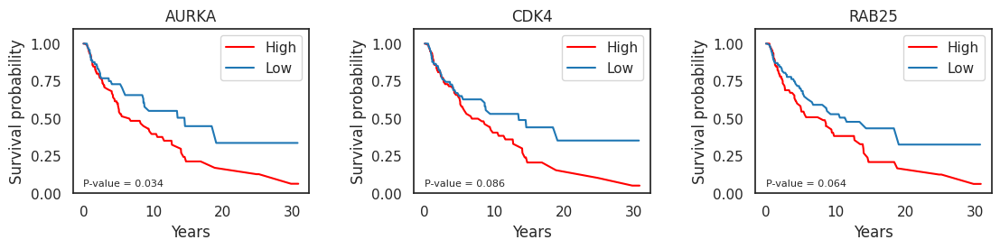

In [35]:
#Conduct survival analysis
pval = 0.1
qval = 0.25

surv_sum_df,fig,m1,m2,mut_surv=av.survival_analysis(df_mut_exp_samples.columns,clinical_f,all_mut_score_nn_df,
                                                    'significant',pval)

#Show statistics for the survival analysis
surv_sum_df.loc[(surv_sum_df['MEDIAN_TIME_HIGH']<surv_sum_df['MEDIAN_TIME_LOW'])&
                (surv_sum_df['PVALUE']<pval)&(surv_sum_df['QVALUE']<qval)]

#Save the data & plots
surv_sum_df.to_csv(tbl_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_Survival.csv"),sep=',')
fig.savefig(fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_Survival_plots.pdf"),dpi=600,format='pdf')

display(HTML("<div style='height: 200px; overflow: auto; width: fit-content'>" +
             surv_sum_df.style.to_html() +
             "</div>"))

In [36]:
#pip install ipympl==0.9.3

### <span style="color:red;">Get neoPPI-regulated genes</span>

#### Define cancer type for the analysis 

In [37]:
#Define cancer type & update PPI scores 
cancer = 'SKCM'
df_mut_exp_samples,df_wt_exp_samples = av.get_wt_mut_expression(cancer,params)
all_mut_score_nn_df,all_wt_score_nn_df,scores_mut_nn_df,scores_wt_nn_df = av.calculate_ppi_scores_not_scaled(cancer,params,
                                                                                        df_wt_exp_samples,df_mut_exp_samples)

Total samples: 470
Samples with target mutation(s): 204
Wild type samples: 224


#### Calculate correlations between neoPPI scores and gene expression

In [38]:
#neoPPI-correlated genes
corr_dict = av.calculate_correlations(df_mut_exp_samples,df_wt_exp_samples,partners,all_mut_score_nn_df,all_wt_score_nn_df)

#Save it
folder = tbl_folder+'Correlated_genes/'
if not os.path.exists(folder):
    os.makedirs(folder)
for p in corr_dict.keys():
    corr_dict[p].to_csv(folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+p+"_correlated_genes.csv"),sep=',')
print("The analysis of neoPPI-correlated genes as been completed.")

IntProgress(value=0, max=3)

The analysis of neoPPI-correlated genes as been completed.


In [39]:
corr_dict['AURKA'].head()

,CORR_BP_MUT,N_MUT,CORR_BP_WT,N_WT,PVAL_BP_MUT,QVAL_BP_MUT,PVAL_BP_WT,QVAL_BP_WT,PVAL,QVAL
GENE,,,,,,,,,,
EZHIP,0.044056,197,0.200441,217,0.538741,0.690682,0.003019,0.008894,0.054250,0.305448
EFCAB8,0.040318,198,0.103823,215,0.572777,0.718706,0.129122,0.222632,0.259923,0.438521
TRIM75,0.064592,200,0.139003,219,0.363513,0.528940,0.039853,0.084616,0.222557,0.423300
GTPBP6,-0.152536,196,-0.168902,210,0.032814,0.085565,0.014260,0.035169,0.433332,0.487066
EFCAB12,-0.226623,195,-0.012712,210,0.001443,0.005946,0.854699,0.905153,0.014820,0.225358


#### or load from file

In [40]:
#Load correlated genes from file
cancer = 'SKCM'
folder = tbl_folder+'Correlated_genes/'
corr_dict = {}
for partner in partners:
    corr_dict[partner] = pd.read_csv(folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+partner+"_correlated_genes.csv"),sep=',',index_col=0)

#### Get Signature genes for a single binding partner

In [41]:
#Select the partner:
partner = "AURKA"

In [42]:
#Get signature genes
def on_value_change(change):
    global sig_genes
    [box.children[0].children[x].observe(on_value_change, names='value') for x in range(0,4)];
    sig_genes, tbl = av.get_signature_genes2(corr_dict,partner,driver_gene,box.children[0].children[0].value,
                    box.children[0].children[1].value,box.children[0].children[2].value,box.children[0].children[3].value)
    return(box,sig_genes)

display(HTML("<div style='height: 200px; overflow: auto; width: fit-content'>" +
             corr_dict[partner].sort_values(by=['CORR_BP_MUT'],ascending=False).style.to_html() +
             "</div>"))
box,sig_genes = av.display_signature_genes(corr_dict,partner,driver_gene)
[box.children[0].children[x].observe(on_value_change, names='value') for x in range(0,4)];
display(box)

,CORR_BP_MUT,N_MUT,CORR_BP_WT,N_WT,PVAL_BP_MUT,QVAL_BP_MUT,PVAL_BP_WT,QVAL_BP_WT,PVAL,QVAL
GENE,,,,,,,,,,
AURKA,0.806997,196,0.767285,216,0.000000,0.000000,0.000000,0.000000,0.146128,0.382781
TPX2,0.798275,196,0.693081,213,0.000000,0.000000,0.000000,0.000000,0.008051,0.199577
NCAPG2,0.781229,192,0.735489,215,0.000000,0.000000,0.000000,0.000000,0.140308,0.378710
BUB1,0.775636,198,0.815282,215,0.000000,0.000000,0.000000,0.000000,0.137618,0.377008
RACGAP1,0.761237,194,0.731698,212,0.000000,0.000000,0.000000,0.000000,0.252348,0.435833
CSE1L,0.760071,192,0.731143,209,0.000000,0.000000,0.000000,0.000000,0.258703,0.437740
BRAF,0.753731,196,0.736207,219,0.000000,0.000000,0.000000,0.000000,0.345429,0.465848
MCM8,0.753497,194,0.758599,214,0.000000,0.000000,0.000000,0.000000,0.452541,0.491257
CENPI,0.744785,196,0.779465,222,0.000000,0.000000,0.000000,0.000000,0.200644,0.413293


#### Build a Cytoscape network for the signature genes

<div style="color:red;font-size: 18px;"> #Network of the signature genes cell is disabled</div>
<div style="color:blue;font-size: 18px;">Note: the network generation requires the Cytoscape to be application executed on a local machine. <br> This functionality is currently not availble within the Code Ocean Capsule</div>
<div style="color:black;font-size: 18px;">Please access the fully functioning version of the AVERON Notebook at <a>https://github.com/aivanovlab/averon_notebook</a></div>

In [43]:
#Network of the signature genes
'''
node_df = pd.DataFrame(sig_genes)
node_df['PARTNER']=partner
types = [[g,"GENE"] for g in sig_genes]
types.append([partner,'PARTNER'])
types_df = pd.DataFrame(types,columns=['node','type'])
p4c,file = av.display_cynetwork3(params,cancer,node_df,types_df, ['red','blue'],['PARTNER','GENE'],layout='force-directed')
p4c.notebook_show_image(file)
''';

#### Get Signature genes of multiple neoPPIs

In [44]:
#Get signature genes of multiple neoPPIs
CORR_BP_MUT = 0.33
PVAL_BP_MUT = 0.05
PVAL = 0.05
QVAL = 0.25
sign_gene_dict = {}
sign_gene_dict,sign_gene_df= av.get_signature_genes_for_multiple_binding_partners(CORR_BP_MUT,PVAL_BP_MUT,PVAL,QVAL,corr_dict,cancer,driver_gene,driver_mut)
#Show the table
display(HTML("<div style='height: 200px; overflow: auto; width: fit-content'>" + sign_gene_df.style.to_html() + "</div>"))
#Save it!
sign_gene_df.to_csv(tbl_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_signature_genes.csv"),sep=",")

,CORR_BP_MUT,N_MUT,CORR_BP_WT,N_WT,PVAL_BP_MUT,QVAL_BP_MUT,PVAL_BP_WT,QVAL_BP_WT,PVAL,QVAL,CANCER,DRIVER,PARTNER
AACS,0.379498,190,0.153115,214,0.000000,0.000001,0.025092,0.057294,0.007326,0.198055,SKCM,BRAF_p.V600E,AURKA
ADSL,0.469645,193,0.277890,213,0.000000,0.000000,0.000039,0.000162,0.012565,0.218966,SKCM,BRAF_p.V600E,AURKA
ATIC,0.393448,193,0.207604,214,0.000000,0.000000,0.002269,0.006890,0.020094,0.239667,SKCM,BRAF_p.V600E,AURKA
AURKB,0.523905,195,0.350153,215,0.000000,0.000000,0.000000,0.000001,0.015041,0.226020,SKCM,BRAF_p.V600E,AURKA
BRI3BP,0.441849,196,0.260588,211,0.000000,0.000000,0.000129,0.000491,0.018808,0.237151,SKCM,BRAF_p.V600E,AURKA
RHNO1,0.439157,193,0.265891,209,0.000000,0.000000,0.000100,0.000389,0.024082,0.248616,SKCM,BRAF_p.V600E,AURKA
NOPCHAP1,0.367416,189,0.048402,214,0.000000,0.000002,0.481226,0.607049,0.000403,0.097167,SKCM,BRAF_p.V600E,AURKA
TEDC2,0.435185,195,0.226143,215,0.000000,0.000000,0.000838,0.002799,0.008884,0.200391,SKCM,BRAF_p.V600E,AURKA
RMI2,0.406497,195,0.192390,215,0.000000,0.000000,0.004640,0.013089,0.008780,0.200077,SKCM,BRAF_p.V600E,AURKA
CYREN,0.387053,192,0.206744,215,0.000000,0.000000,0.002313,0.007004,0.023582,0.248616,SKCM,BRAF_p.V600E,AURKA


#### COMPARE SIGNATURE GENES OF DIFFERENT NEOPPIS

#### Distribution of the size of neoPPI-regulated gene sets

,neoPPI,SIZE
2,RAB25,260
1,AURKA,62
0,CDK4,37


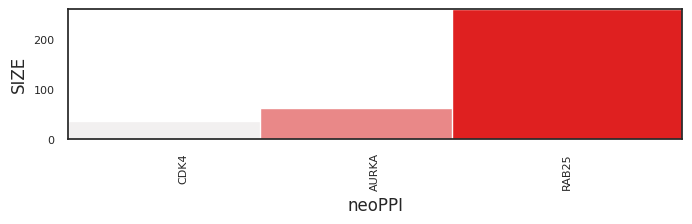

In [45]:
#Size distribution of neoPPI-regulated gene sets
fig,stat_df = av.neoPPI_genes_distr(sign_gene_dict,'red',8,8)
fig.savefig(fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,
                        "_signature_genes_hist.pdf"),dpi=600,format="pdf")
stat_df.sort_values(by='SIZE',ascending=False).head(10)

#### Heatmap: neoPPI-regulated gene set similarity; Jaccard score

Average Jaccard Index:  3.7 %


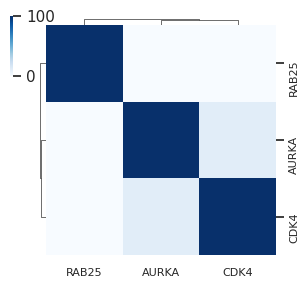

In [46]:
#neoPPI-signature gene set overlap, JACCARD score
g=av.jaccard(sign_gene_dict,fig_folder,'Blues',8,8)
g.savefig(fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,
                        "_jaccard_heatmap1.pdf"),dpi=600,format='pdf')

#### Regression plots for a specific signature gene in Mut and WT samples

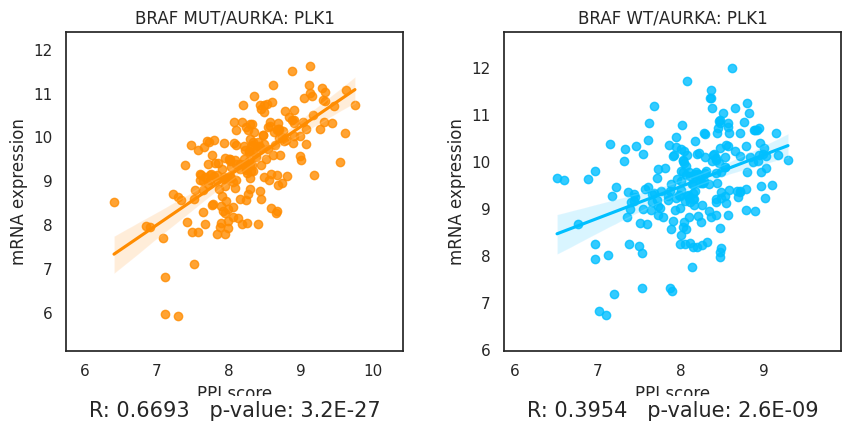

In [47]:
#PPI-score/mRNA expression correaltion
partner='AURKA'
gene = 'PLK1'       
fig = av.ppi_score_mrna_corr(gene,driver_gene,partner,all_mut_score_nn_df,all_wt_score_nn_df,
                             df_mut_exp_samples,df_wt_exp_samples,'darkorange','deepskyblue')
#Save it
fig_file = fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+partner+"_"+gene+"_correlattion_plot.png")
fig.savefig(fig_file, dpi=600,format='png')

### Enrichment analysis

#### Define the pathways gene sets to analyze

In [48]:
#Define the pathway gene sets to analyze

#Currently Averon uses genesets defined in MSigDB: https://www.gsea-msigdb.org/gsea/msigdb
pathway_files = ["h.all.v2022.1.Hs.symbols.gmt", "c2.cp.kegg.v2022.1.Hs.symbols.gmt", "c2.cp.reactome.v2022.1.Hs.symbols.gmt"]
params['pathway_files']=pathway_files

#### Conduct the pathway enrichment analysis

In [49]:
#Conduct the pathway enrichment analysis

#If partner = "", the enrichemnt analysis will be conducted for all binding partners

#If a particular partner is specified, the analysis will be conducted just for this partner

#partner="AURKA" #specify a particular binding partner
partner = "" #uncomment this line to use all the partners for the analysis

bars_dict,enrichment_dict=av.pathway(sign_gene_dict,pathway_files,partner,coding_genes,pathway_folder)
print("Pathway enrichment analysis completed!")

IntProgress(value=0, max=3)

Pathway enrichment analysis completed!


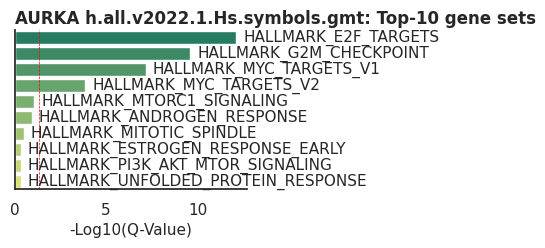

In [50]:
#Show bar graphs
partner = 'AURKA'
pathway = "h.all.v2022.1.Hs.symbols.gmt"
fig = bars_dict[partner][pathway]
fig

In [51]:
#Save the bar graph
fig_file = fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+partner+"_Enrichment_"+
                                      (".").join(pathway.split(".")[:-1])+".png")
fig.savefig(fig_file, dpi=600,format='png')

In [52]:
#av.save_enrichment_figs(bars_dict,params,cancer) #Uncomment to save all enrichment bargraphs as figures

In [53]:
#Show the enrichment statistics
partner = "AURKA"
qval = 0.05
enrichment_df = enrichment_dict[partner]
enrichment_df = enrichment_df.loc[enrichment_df['qvalue']<qval].sort_values(by=['qvalue'])
display(HTML("<div style='height: 400px; overflow: auto;width: fit-content'>" +
             enrichment_df.style.set_properties(**{'text-align': 'left'}).to_html() +
             enrichment_df.style.to_html() + 
             "</div>"))

,SET,pvalue,num_sig_genes,num_sig_genes_included,num_genes_in_pathway,"Expected, %","Actual, %",Enrichment,sig_genes_included,qvalue
80,REACTOME_CELL_CYCLE,0.000000,62,21,693,3.522236,33.870968,9.616325,MYBL2; POLE; TUBA1B; CDT1; CDC45; RMI2; RHNO1; FOXM1; AURKB; CENPA; GTSE1; CENPH; CENPM; MCM5; NUP37; PKMYT1; TPX2; PLK1; MCM2; TK1; CDK4,0.000000
245,REACTOME_CELL_CYCLE_MITOTIC,0.000000,62,19,561,2.851334,30.645161,10.747657,MYBL2; POLE; TUBA1B; CDT1; CDC45; FOXM1; AURKB; CENPA; GTSE1; CENPH; CENPM; MCM5; NUP37; PKMYT1; TPX2; PLK1; MCM2; TK1; CDK4,0.000000
8,HALLMARK_E2F_TARGETS,0.000000,62,13,200,1.016518,20.967742,20.627016,MYBL2; POLE; RANBP1; AURKB; CENPM; MCM5; PHF5A; PLK1; KIF18B; XRCC6; MCM2; TK1; CDK4,0.000000
1,HALLMARK_G2M_CHECKPOINT,0.000000,62,11,200,1.016518,17.741935,17.453629,MYBL2; POLE; CDC45; AURKB; CENPA; MCM5; TPX2; PLK1; TROAP; MCM2; CDK4,0.000000
251,REACTOME_CELL_CYCLE_CHECKPOINTS,0.000000,62,13,291,1.479034,20.967742,14.176643,CDC45; RMI2; RHNO1; AURKB; CENPA; GTSE1; CENPH; CENPM; MCM5; NUP37; PKMYT1; PLK1; MCM2,0.000000
9,HALLMARK_MYC_TARGETS_V1,0.000000,62,9,200,1.016518,14.516129,14.280242,RANBP1; CDC45; SF3B3; MCM5; SNRPD3; XRCC6; EIF4A1; MCM2; CDK4,0.000000
166,REACTOME_MITOTIC_G1_PHASE_AND_G1_S_TRANSITION,0.000000,62,8,149,0.757306,12.903226,17.038320,MYBL2; POLE; CDT1; CDC45; MCM5; MCM2; TK1; CDK4,0.000002
236,REACTOME_ACTIVATION_OF_THE_PRE_REPLICATIVE_COMPLEX,0.000000,62,5,33,0.167726,8.064516,48.081623,POLE; CDT1; CDC45; MCM5; MCM2,0.000004
123,REACTOME_RESOLUTION_OF_SISTER_CHROMATID_COHESION,0.000000,62,7,126,0.640407,11.290323,17.629928,TUBA1B; AURKB; CENPA; CENPH; CENPM; NUP37; PLK1,0.000007
68,REACTOME_POLO_LIKE_KINASE_MEDIATED_EVENTS,0.000000,62,4,16,0.081321,6.451613,79.334677,MYBL2; FOXM1; PKMYT1; PLK1,0.000007


### Build Networks for the enrichment analysis

In [54]:
#Connect Mutant driver - Partner - Pathway

#Set the qval threshold:
qval=0.05
all_enrichment_df,all_enrichment_types_df=av.connect_mutant_driver_partner_pathway(enrichment_dict,driver_gene,qval)

#### Build an interactive network

<div style="color:red;font-size: 18px;"> #Network of the signature genes cell is disabled</div>
<div style="color:blue;font-size: 18px;">Note: the network generation requires the Cytoscape to be application executed on a local machine. <br> This functionality is currently not availble within the Code Ocean Capsule</div>

In [55]:
#Interactive network 
'''
selected_partners = ['AURKA','CDK4','RAB25'] #indicate partners to use. We don't recommentd to use more than 10 partners
ipycytoscape_obj = av.create_interactive_network2(all_enrichment_df.loc[all_enrichment_df['Partner'].isin(selected_partners)],
                                                  all_enrichment_types_df,
                                                  colors=['green','red','blue','orange'])
ipycytoscape_obj
'''

"\nselected_partners = ['AURKA','CDK4','RAB25'] #indicate partners to use. We don't recommentd to use more than 10 partners\nipycytoscape_obj = av.create_interactive_network2(all_enrichment_df.loc[all_enrichment_df['Partner'].isin(selected_partners)],\n                                                  all_enrichment_types_df,\n                                                  colors=['green','red','blue','orange'])\nipycytoscape_obj\n"

#### Build a Cytoscape network

<span style="color:green"> Have the Cytoscape application open before you execute the next cell </span><br>
<span style="color:green"> The AVERON was tested using Cytoscape_3.10.0 </span><br>
<span style="color:green"> Cytoscape is available here: </span>https://cytoscape.org/ <br>

<div style="color:red;font-size: 18px;"> #Network of the signature genes cell is disabled</div>
<div style="color:blue;font-size: 18px;">Note: the network generation requires the Cytoscape to be application executed on a local machine. <br> This functionality is currently not availble within the Code Ocean Capsule</div>

In [56]:
#Cytoscape network
'''
p4c = av.display_cynetwork2(all_enrichment_df,all_enrichment_types_df,
                           colors=['#04DB00','#00CCCC','#CCCC00'],layout='force-directed')
os.chdir(fig_folder)
file = fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_pathway_network.png")
p4c.export_image(file,overwrite_file=True); 
#Save network to file
p4c.export_network(net_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_pathway_network.sif"),type='SIF',overwrite_file=True);
p4c.notebook_show_image(file)
'''

'\np4c = av.display_cynetwork2(all_enrichment_df,all_enrichment_types_df,\n                           colors=[\'#04DB00\',\'#00CCCC\',\'#CCCC00\'],layout=\'force-directed\')\nos.chdir(fig_folder)\nfile = fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_pathway_network.png")\np4c.export_image(file,overwrite_file=True); \n#Save network to file\np4c.export_network(net_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_pathway_network.sif"),type=\'SIF\',overwrite_file=True);\np4c.notebook_show_image(file)\n'

#### Enrichment heatmap

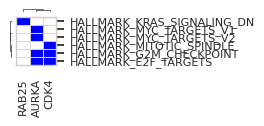

In [57]:
#Enrichment heatmap

#Set the qval threshold:
qval=0.05
all_enrichment_df,all_enrichment_types_df=av.connect_mutant_driver_partner_pathway(enrichment_dict,driver_gene,qval)

#select subset of pathway genesets to use
#e.g. HALLMARK, KEGG, REACTOME
subset = "HALLMARK"
g=av.enrichment_heatmap(subset,all_enrichment_df,driver_gene,fig_folder,'blue','auto')
g.savefig(fig_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+subset+"_Enrichment_heatmap.pdf"),dpi=600,format='pdf')

#### Generate text description for predicted neoPPI functions

In [58]:
#Generate text description
partner="AURKA"
qval = 0.05
description = av.get_txt_description_of_regulations(partner,enrichment_dict,qval,params)
a = ('<br>').join(description)
display(HTML("<div style='height: 400px;overflow: auto;width: 2000px'>" + a + "</div>"))
#Save it!
fname = tbl_folder+av.gen_filename(driver_gene,driver_mut,cancer,"_"+partner+"_neoPPI_functions.txt")
with open(fname, 'w') as f:
    f.write(("\n").join(description))

### Determine neoPPI signature genes which contribute in worsened clinical outcomes in the mutated samples

In [59]:
#Clinically significant neoPPI-signature genes

#use partners to determine clinically significant signature genes for all neoPPIs 
#or provide a subset of neo binding partners e.g. ['AURKA'] or ['AURKA','RAB25','CDK4']
#out_df = av.sign_genes_survival(df_mut_exp_samples,sign_gene_dict,params,cancer,['AURKA','RAB25','CDK4'])
survival_df,sign_gene_dict,survival_plots = av.sign_genes_survival(df_mut_exp_samples,sign_gene_dict,params,cancer,partners)
display(HTML("<div style='height: 400px; overflow: auto;width: fit-content'>" +
             survival_df.loc[survival_df['CLIN_FDR']<0.1].sort_values(by=['CLIN_FDR']).style.to_html() + 
             "</div>"))

IntProgress(value=0, max=3)

,CORR_BP_MUT,N_MUT,CORR_BP_WT,N_WT,PVAL_BP_MUT,QVAL_BP_MUT,PVAL_BP_WT,QVAL_BP_WT,PVAL,QVAL,CANCER,DRIVER,PARTNER,med_time_high,med_time_low,CLIN_PVAL,CLIN_FDR
GENE,,,,,,,,,,,,,,,,,
FAM83C,0.885926,197,0.770956,218,0.000000,0.000000,0.000000,0.000000,0.000062,0.016937,SKCM,BRAF_p.V600E,RAB25,3.652055,9.460273,0.000043,0.011160
POF1B,0.845523,194,0.767540,215,0.000000,0.000000,0.000000,0.000000,0.011768,0.143441,SKCM,BRAF_p.V600E,RAB25,4.950685,12.695890,0.000206,0.026816
FOXM1,0.474696,193,0.259465,212,0.000000,0.000000,0.000133,0.000597,0.006213,0.212176,SKCM,BRAF_p.V600E,CDK4,5.087671,19.049314,0.000731,0.027038
KRT17,0.819726,195,0.744692,211,0.000000,0.000000,0.000000,0.000000,0.025650,0.186403,SKCM,BRAF_p.V600E,RAB25,3.652055,12.695890,0.000396,0.034336
DSG1,0.887308,198,0.805786,217,0.000000,0.000000,0.000000,0.000000,0.001479,0.073441,SKCM,BRAF_p.V600E,RAB25,4.082191,10.599999,0.000538,0.034940
BRI3BP,0.364100,192,0.048996,216,0.000000,0.000003,0.473780,0.602697,0.000437,0.103567,SKCM,BRAF_p.V600E,CDK4,4.241096,9.460273,0.002047,0.037878
FADS6,0.840215,199,0.691754,218,0.000000,0.000000,0.000000,0.000000,0.000088,0.018699,SKCM,BRAF_p.V600E,RAB25,4.082191,13.975341,0.000893,0.041849
SOWAHB,0.743606,196,0.644650,211,0.000000,0.000000,0.000000,0.000000,0.027107,0.189176,SKCM,BRAF_p.V600E,RAB25,4.082191,13.975341,0.001002,0.041849
KPRP,0.767463,201,0.663302,217,0.000000,0.000000,0.000000,0.000000,0.014452,0.156370,SKCM,BRAF_p.V600E,RAB25,4.073972,11.567122,0.001771,0.041849


In [60]:
#Save survival plots

pval = 0.05
qval = 0.25
av.save_survival_plots(survival_plots,pval, qval,partner,params,cancer,survival_df)

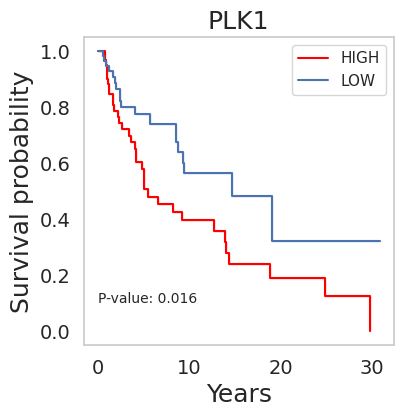

In [61]:
#Survival plot for a single gene
gene = 'PLK1'
#Save it
av.single_gene_survival_plot(df_mut_exp_samples,gene,clinical_f)[0].savefig(fig_folder+'survival_'+gene+'.pdf',dpi=600,format='pdf')
av.single_gene_survival_plot(df_mut_exp_samples,gene,clinical_f)[0]

### Identify drugs available for neoPPI-regulated genes

In [ ]:
#Gene-drug connectivity

#Set p-value and q-value tresholds for gene clinical significance:
pval = 0.05
qval = 0.25

#use partners to determine clinically significant signature genes for all neoPPIs 
#or provide a subset of neo binding partners e.g. ['AURKA'] or ['AURKA','RAB25','CDK4']:
#clin_genes,ligands_df,gene_drugs_df,ofile = av.get_drugs(sign_gene_dict,pval,qval,params,cancer,['AURKA','RAB25','CDK4'])

clin_genes,ligands_df,gene_drugs_df,ofile = av.get_drugs(sign_gene_dict,pval,qval,params,cancer,partners)
display(HTML("<div style='height: 400px; overflow: auto;width: fit-content'>" + 
             gene_drugs_df.style.to_html() + "</div>" +
            "<span>" + "Gene-drug connectivity table was saved to <br>" + ofile + "</span"))

There are a total of: 93 clinical genes


IntProgress(value=0, max=93)